In [5]:
import sys
!{sys.executable} -m pip install nbformat



[notice] A new release of pip is available: 24.2 -> 25.1.1
[notice] To update, run: pip3 install --upgrade pip


In [6]:

import nbformat

path = "Reza's_ML&PA_Assignment.ipynb"
with open(path, "r", encoding="utf-8") as f:
    nb = nbformat.read(f, as_version=4)

if 'widgets' in nb['metadata']:
    del nb['metadata']['widgets']

with open(path, "w", encoding="utf-8") as f:
    nbformat.write(nb, f)
print("Widget metadata removed.")


Widget metadata removed.


In [ ]:
def load_kaggle_dataset(dataset: str, file_name: str, kaggle_username: str, kaggle_key: str):
    """
    Automatically authenticate with Kaggle, download and load a semicolon-separated CSV into a DataFrame.

    Parameters:
        dataset (str): The Kaggle dataset identifier, e.g., "rodsaldanha/arketing-campaign"
        file_name (str): The expected CSV file name inside the downloaded zip
        kaggle_username (str): Your Kaggle username
        kaggle_key (str): Your Kaggle API key

    Returns:
        pd.DataFrame: Loaded dataset as a pandas DataFrame
    """
    import os
    import json
    import pandas as pd

    # Step 1: Install Kaggle API (quietly)
    !pip install -q kaggle

    # Step 2: Write the credentials
    os.makedirs("/root/.kaggle", exist_ok=True)
    kaggle_json_path = "/root/.kaggle/kaggle.json"
    with open(kaggle_json_path, "w") as f:
        json.dump({"username": kaggle_username, "key": kaggle_key}, f)
    os.chmod(kaggle_json_path, 0o600)

    # Step 3: Download the dataset
    !kaggle datasets download -d {dataset} --force

    # Step 4: Unzip
    zip_name = dataset.split("/")[-1] + ".zip"
    !unzip -o -q {zip_name}

    # Step 5: Load CSV with semicolon separator
    df = pd.read_csv(file_name, sep=';', engine='python')
    print(f"✅ Loaded '{file_name}' with shape {df.shape}")
    return df


In [ ]:
df = load_kaggle_dataset(
    dataset="rodsaldanha/arketing-campaign",
    file_name="marketing_campaign.csv",
    kaggle_username="mohammadrezahassani",
    kaggle_key="55305b236dd5b58e57f69810adcfaff4"
)


Dataset URL: https://www.kaggle.com/datasets/rodsaldanha/arketing-campaign
License(s): other
  0% 0.00/352k [00:00<?, ?B/s]
100% 352k/352k [00:00<00:00, 453MB/s]
✅ Loaded 'marketing_campaign.csv' with shape (2240, 29)


In [ ]:
import pandas as pd
from datetime import datetime

def preprocess_customer_data(df: pd.DataFrame) -> pd.DataFrame:
    """
    Perform data preprocessing on the customer dataframe:
    - Convert Year_Birth to age (based on year 2025)
    - One-hot encode Education
    - Clean and one-hot encode Marital_Status
    - Drop rows with missing values
    - Add Number_Of_Kids by summing Teenhome and Kidhome
    - Add Customer_For by calculating duration since Dt_Customer
    """
    # 1. Convert Year_Birth to Age
    df['Age'] = 2020 - df['Year_Birth']

    # 2. One-hot encode Education
    df = pd.get_dummies(df, columns=['Education'], prefix='Education', dtype=int)

    # 3. Drop absurd/YOLO from Marital_Status
    df = df[~df['Marital_Status'].isin(['Absurd', 'YOLO'])]

    # 4. Replace "Alone" with "Single"
    df['Marital_Status'] = df['Marital_Status'].replace('Alone', 'Single')

    # 5. One-hot encode Marital_Status
    df = pd.get_dummies(df, columns=['Marital_Status'], prefix='Marital', dtype=int)

    # 6. Drop rows with any missing values
    df = df.dropna()

    # 7. Add Number_Of_Kids
    df['Number_Of_Kids'] = df['Kidhome'] + df['Teenhome']

    # 8. Calculate Customer_For in years from Dt_Customer to May 2025
    df['Dt_Customer'] = pd.to_datetime(df['Dt_Customer'], errors='coerce')
    df['Customer_For'] = (pd.Timestamp("2020-05-01") - df['Dt_Customer']).dt.days // 30

    return df


In [ ]:
cleaned_df = preprocess_customer_data(df)

In [ ]:
def generate_ydata_profile(df):
    """
    Generate and display a ydata-profiling report in Google Colab.
    Handles broken context options and Colab compatibility.
    """
    import sys
    import subprocess

    def install(package):
        subprocess.check_call([sys.executable, "-m", "pip", "install", package, "--quiet"])

    # Install and import required packages
    try:
        import pandas as pd
        from ydata_profiling import ProfileReport
    except ImportError:
        install("ydata-profiling")
        import pandas as pd
        from ydata_profiling import ProfileReport

    try:
        from IPython.display import display, HTML
    except ImportError:
        install("IPython")
        from IPython.display import display, HTML

    # Create the profile report
    profile = ProfileReport(df, title="YData Profile Report", explorative=True)

    # Display using iframe (Colab compatible)
    return profile.to_notebook_iframe()


In [ ]:
generate_ydata_profile(cleaned_df)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 40/40 [00:00<00:00, 55.09it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
cleaned_df

,ID,Year_Birth,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,...,Education_Graduation,Education_Master,Education_PhD,Marital_Divorced,Marital_Married,Marital_Single,Marital_Together,Marital_Widow,Number_Of_Kids,Customer_For
0,5524,1957,58138.0,0,0,2012-09-04,58,635,88,546,...,1,0,0,0,0,1,0,0,0,93
1,2174,1954,46344.0,1,1,2014-03-08,38,11,1,6,...,1,0,0,0,0,1,0,0,2,74
2,4141,1965,71613.0,0,0,2013-08-21,26,426,49,127,...,1,0,0,0,0,0,1,0,0,81
3,6182,1984,26646.0,1,0,2014-02-10,26,11,4,20,...,1,0,0,0,0,0,1,0,1,75
4,5324,1981,58293.0,1,0,2014-01-19,94,173,43,118,...,0,0,1,0,1,0,0,0,1,76
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,61223.0,0,1,2013-06-13,46,709,43,182,...,1,0,0,0,1,0,0,0,1,83
2236,4001,1946,64014.0,2,1,2014-06-10,56,406,0,30,...,0,0,1,0,0,0,1,0,3,71
2237,7270,1981,56981.0,0,0,2014-01-25,91,908,48,217,...,1,0,0,1,0,0,0,0,0,76
2238,8235,1956,69245.0,0,1,2014-01-24,8,428,30,214,...,0,1,0,0,0,0,1,0,1,76


In [ ]:
from sklearn.model_selection import train_test_split


from sklearn.model_selection import train_test_split
import pandas as pd

def prepare_train_test_split(df: pd.DataFrame, test_size: float = 0.2, random_state: int = 42):
    """
    Prepare features and target variables, and split the dataset into training and test sets.

    Parameters:
    - df (pd.DataFrame): The original dataframe.
    - test_size (float): Proportion of dataset to include in the test split.
    - random_state (int): Controls the shuffling applied to the data before the split.

    Returns:
    - X_train (pd.DataFrame): Training features.
    - X_test (pd.DataFrame): Testing features.
    - y_train (pd.Series): Training labels.
    - y_test (pd.Series): Testing labels.
    """
    # Define columns to exclude
    drop_cols = ['ID', 'Year_Birth', 'Dt_Customer', 'Z_CostContact', 'Z_Revenue', 'Response', 'index']

    # Ensure the columns exist before trying to drop them
    df_cleaned = df.drop(columns=[col for col in drop_cols if col in df.columns])

    # Define X and y
    X = df_cleaned.copy()
    y = df['Response']

    # Split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=random_state)

    return X_train, X_test, y_train, y_test


In [ ]:
# Assuming cleaned_df is already defined
X_train, X_test, y_train, y_test = prepare_train_test_split(cleaned_df)


In [ ]:
def explore_class_balance(y_train):
    import matplotlib.pyplot as plt
    import seaborn as sns
    counts = y_train.value_counts()
    plt.figure(figsize=(5,3))
    sns.barplot(x=counts.index.astype(str), y=counts.values)
    plt.title("Class Distribution")
    plt.xlabel("Response")
    plt.ylabel("Count")
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    return counts / counts.sum()


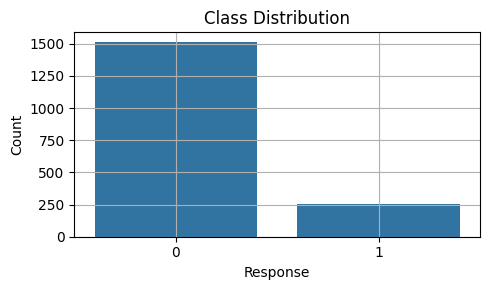

,count
Response,
0,0.855285
1,0.144715


In [ ]:
explore_class_balance(y_train=y_train)

In [ ]:
def log_reg_feature_importance(X_train, y_train):
    from sklearn.linear_model import LogisticRegression
    import pandas as pd
    import numpy as np

    model = LogisticRegression(max_iter=1000000, class_weight='balanced')
    model.fit(X_train, y_train)
    coefs = pd.Series(model.coef_[0], index=X_train.columns)
    return coefs.sort_values(key=np.abs, ascending=False)


In [ ]:
log_reg_feature_importance(X_train=X_train,y_train=y_train)

/usr/local/lib/python3.11/dist-packages/sklearn/linear_model/_logistic.py:465: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. OF F,G EVALUATIONS EXCEEDS LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


,0
AcceptedCmp3,1.554976
AcceptedCmp5,1.405632
AcceptedCmp1,1.241063
AcceptedCmp4,1.121730
Marital_Together,-0.921222
Marital_Married,-0.804454
AcceptedCmp2,0.701472
Teenhome,-0.693620
Education_PhD,0.692993
Education_2n Cycle,-0.514342


In [ ]:
def plot_feature_response_correlation(X, y):
    import pandas as pd
    import seaborn as sns
    import matplotlib.pyplot as plt

    df = X.copy()
    df['Response'] = y
    corrs = df.corr()['Response'].drop('Response').sort_values(key=abs, ascending=False)
    plt.figure(figsize=(6, 10))
    sns.barplot(x=corrs.values, y=corrs.index)
    plt.title("Feature-Response Correlation")
    plt.tight_layout()
    plt.show()
    return corrs


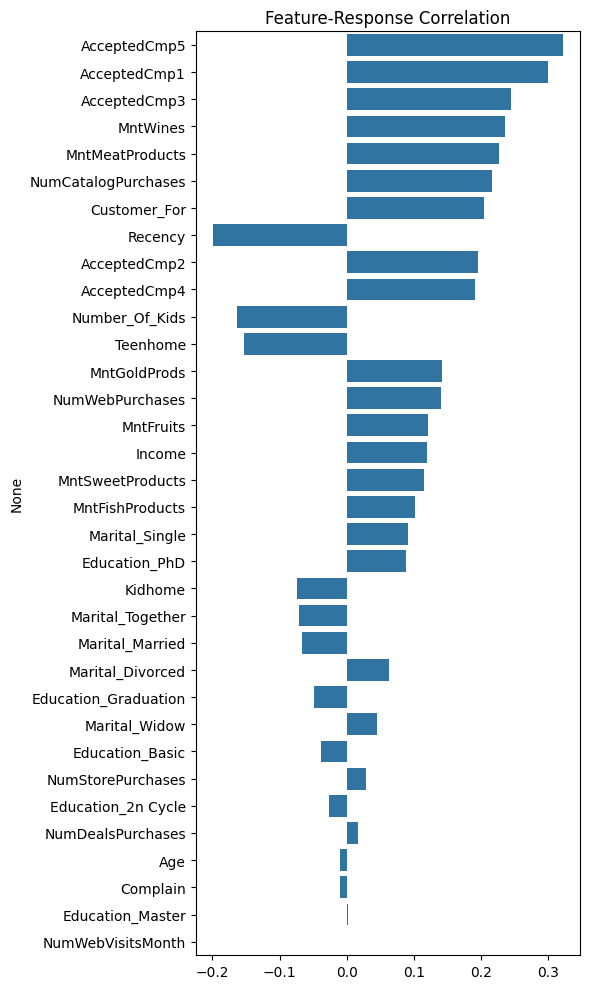

,Response
AcceptedCmp5,0.321453
AcceptedCmp1,0.299977
AcceptedCmp3,0.244996
MntWines,0.236186
MntMeatProducts,0.226576
NumCatalogPurchases,0.216008
Customer_For,0.204529
Recency,-0.198881
AcceptedCmp2,0.195780
AcceptedCmp4,0.190481


In [ ]:
plot_feature_response_correlation(X_train,y_train)

In [ ]:
def evaluate_baseline_models(X_train, X_test, y_train, y_test):
    from sklearn.linear_model import LogisticRegression
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.svm import SVC
    from sklearn.metrics import classification_report
    import warnings
    warnings.filterwarnings('ignore')

    models = {
        'LogReg': LogisticRegression(max_iter=1000000, class_weight='balanced'),
        'RandomForest': RandomForestClassifier(n_estimators=100, class_weight='balanced'),
        'SVC': SVC(probability=True, class_weight='balanced')
    }

    results = {}
    for name, model in models.items():
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
        report = classification_report(y_test, y_pred, output_dict=True)
        results[name] = {
            'Precision': report['1']['precision'],
            'Recall': report['1']['recall'],
            'F1': report['1']['f1-score'],
            'Support': report['1']['support']
        }

    return results


In [ ]:
evaluate_baseline_models(X_train=X_train,X_test=X_test,y_train=y_train,y_test=y_test)

{'LogReg': {'Precision': 0.46564885496183206,
  'Recall': 0.8133333333333334,
  'F1': 0.5922330097087378,
  'Support': 75.0},
 'RandomForest': {'Precision': 0.7391304347826086,
  'Recall': 0.22666666666666666,
  'F1': 0.3469387755102041,
  'Support': 75.0},
 'SVC': {'Precision': 0.34375,
  'Recall': 0.44,
  'F1': 0.38596491228070173,
  'Support': 75.0}}

In [ ]:
def compare_models_all_info(X_train, X_test, y_train, y_test, random_state=42):
    """
    Train Logistic Regression and Random Forest on the provided data,
    return detailed metrics, predictions, and model objects for in-depth comparison.
    """
    import pandas as pd
    import numpy as np
    from sklearn.linear_model import LogisticRegressionCV
    from sklearn.ensemble import RandomForestClassifier
    from sklearn.model_selection import RandomizedSearchCV, cross_validate
    from sklearn.metrics import (precision_score, recall_score, f1_score, accuracy_score,
                                 confusion_matrix, roc_auc_score, roc_curve, precision_recall_curve)

    results = []
    details = {}

    # --- Logistic Regression ---
    log_model = LogisticRegressionCV(cv=5, max_iter=100000, class_weight='balanced', scoring='f1', random_state=random_state)
    log_model.fit(X_train, y_train)
    y_pred_log = log_model.predict(X_test)
    y_proba_log = log_model.predict_proba(X_test)[:, 1]
    cm_log = confusion_matrix(y_test, y_pred_log)

    # Get CV results for LR
    cv_log = cross_validate(log_model, X_train, y_train, cv=5, scoring=['precision', 'recall', 'f1', 'roc_auc'])

    results.append({
        'Model': 'Logistic Regression',
        'Precision': precision_score(y_test, y_pred_log),
        'Recall': recall_score(y_test, y_pred_log),
        'F1': f1_score(y_test, y_pred_log),
        'Accuracy': accuracy_score(y_test, y_pred_log),
        'ROC AUC': roc_auc_score(y_test, y_proba_log),
        'TP': cm_log[1, 1], 'FP': cm_log[0, 1],
        'FN': cm_log[1, 0], 'TN': cm_log[0, 0],
        'Total Contacted': cm_log[0, 1] + cm_log[1, 1]
    })

    details['Logistic Regression'] = {
        'best_estimator': log_model,
        'cv_scores': cv_log,
        'y_pred': y_pred_log,
        'y_proba': y_proba_log,
        'conf_matrix': cm_log,
        'roc_curve': roc_curve(y_test, y_proba_log),
        'pr_curve': precision_recall_curve(y_test, y_proba_log),
        'coef': getattr(log_model, 'coef_', None)
    }

    # --- Random Forest ---
    rf = RandomForestClassifier(class_weight='balanced', random_state=random_state)
    rf_params = {
        'n_estimators': [100, 200],
        'max_depth': [5, None],
        'min_samples_split': [2, 5],
        'min_samples_leaf': [1, 2]
    }
    rf_cv = RandomizedSearchCV(rf, rf_params, n_iter=5, scoring='f1', cv=3, n_jobs=-1, random_state=random_state, return_train_score=True)
    rf_cv.fit(X_train, y_train)
    best_rf = rf_cv.best_estimator_
    y_pred_rf = best_rf.predict(X_test)
    y_proba_rf = best_rf.predict_proba(X_test)[:, 1]
    cm_rf = confusion_matrix(y_test, y_pred_rf)

    # Get CV results for RF
    cv_rf = cross_validate(best_rf, X_train, y_train, cv=5, scoring=['precision', 'recall', 'f1', 'roc_auc'])

    results.append({
        'Model': 'Random Forest',
        'Precision': precision_score(y_test, y_pred_rf),
        'Recall': recall_score(y_test, y_pred_rf),
        'F1': f1_score(y_test, y_pred_rf),
        'Accuracy': accuracy_score(y_test, y_pred_rf),
        'ROC AUC': roc_auc_score(y_test, y_proba_rf),
        'TP': cm_rf[1, 1], 'FP': cm_rf[0, 1],
        'FN': cm_rf[1, 0], 'TN': cm_rf[0, 0],
        'Total Contacted': cm_rf[0, 1] + cm_rf[1, 1]
    })

    details['Random Forest'] = {
        'best_estimator': best_rf,
        'cv_scores': cv_rf,
        'y_pred': y_pred_rf,
        'y_proba': y_proba_rf,
        'conf_matrix': cm_rf,
        'roc_curve': roc_curve(y_test, y_proba_rf),
        'pr_curve': precision_recall_curve(y_test, y_proba_rf),
        'feature_importances': getattr(best_rf, 'feature_importances_', None),
        'search_results': pd.DataFrame(rf_cv.cv_results_)
    }

    # --- Output for custom plots/analysis ---
    df_results = pd.DataFrame(results)
    df_results = df_results[['Model', 'Precision', 'Recall', 'F1', 'Accuracy', 'ROC AUC', 'TP', 'FN', 'FP', 'TN', 'Total Contacted']]

    output = {
        'summary': df_results,
        'details': details
    }
    return output


In [ ]:
df_results = compare_models_all_info(X_train, X_test, y_train, y_test)

In [ ]:
df_results

{'summary':                  Model  Precision    Recall        F1  Accuracy   ROC AUC  TP  \
 0  Logistic Regression   0.462121  0.813333  0.589372  0.808126  0.896721  61   
 1        Random Forest   0.516129  0.640000  0.571429  0.837472  0.887482  48   
 
    FN  FP   TN  Total Contacted  
 0  14  71  297              132  
 1  27  45  323               93  ,
 'details': {'Logistic Regression': {'best_estimator': LogisticRegressionCV(class_weight='balanced', cv=5, max_iter=100000,
                        random_state=42, scoring='f1'),
   'cv_scores': {'fit_time': array([237.42725372, 240.24374223, 240.63064885, 234.70503378,
           233.58621049]),
    'score_time': array([0.026052  , 0.0181818 , 0.01817536, 0.01759648, 0.01762009]),
    'test_precision': array([0.47191011, 0.42105263, 0.44827586, 0.44554455, 0.44444444]),
    'test_recall': array([0.82352941, 0.78431373, 0.76470588, 0.86538462, 0.78431373]),
    'test_f1': array([0.6       , 0.54794521, 0.56521739, 0.58823529, 

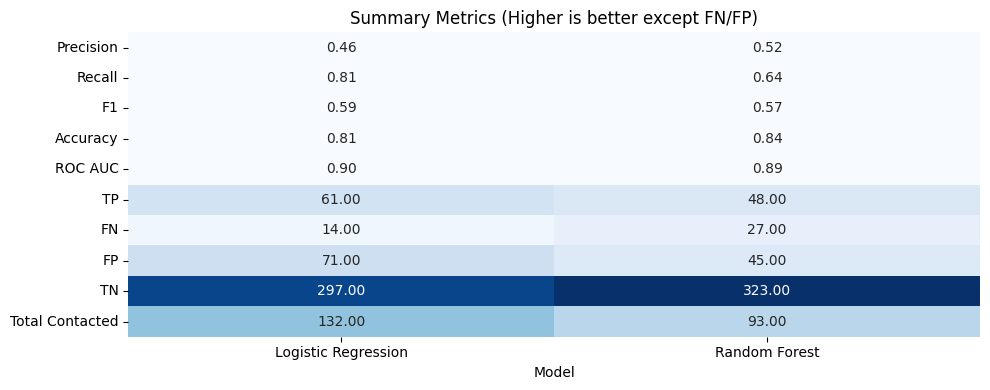

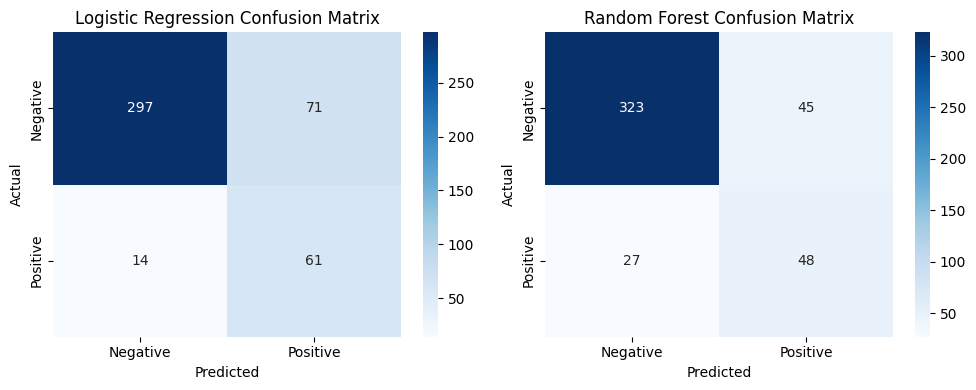

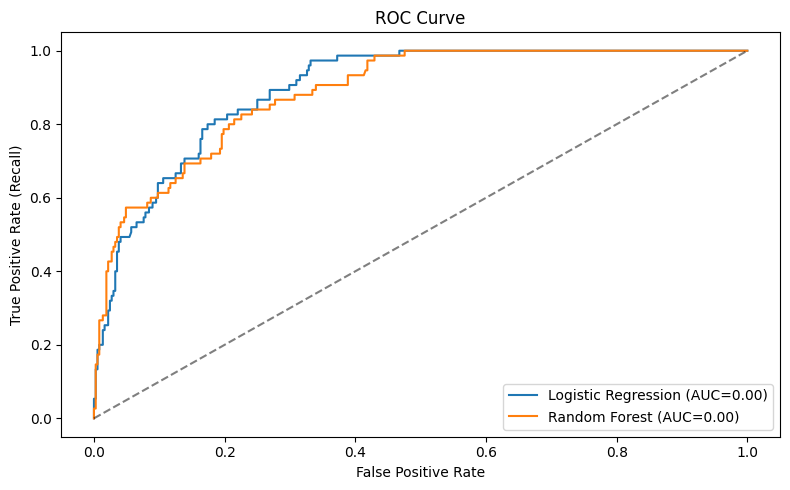

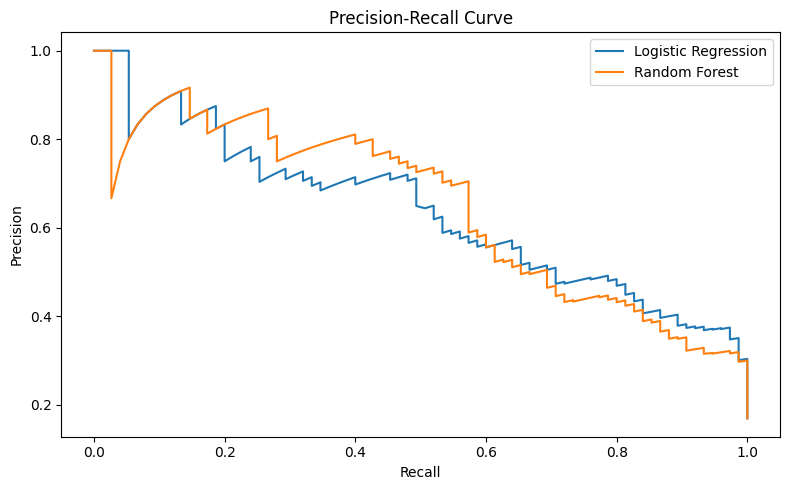

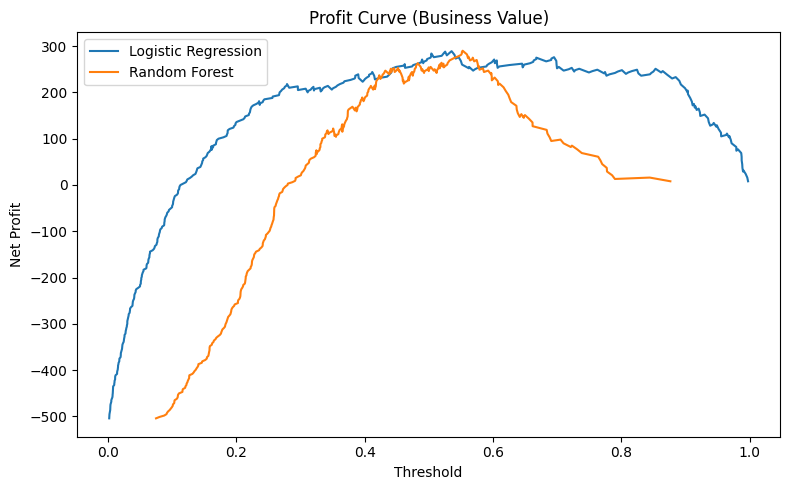

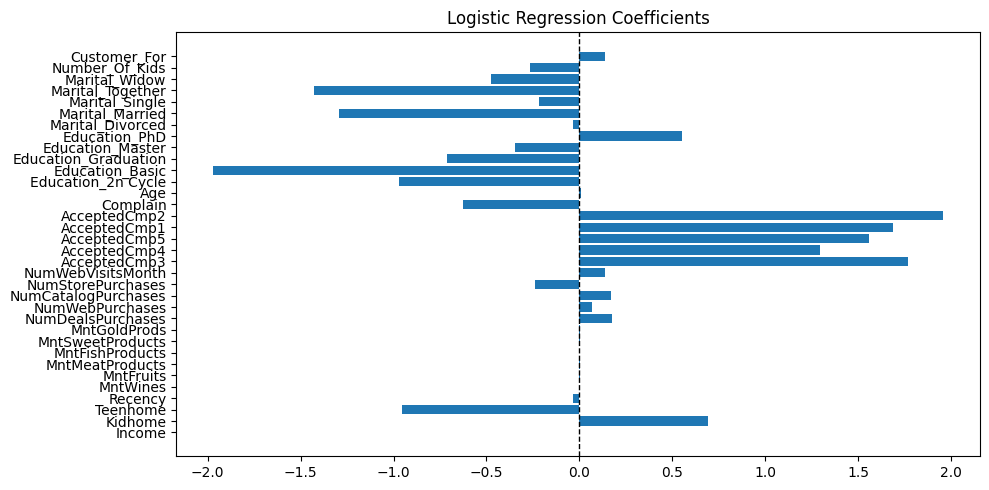

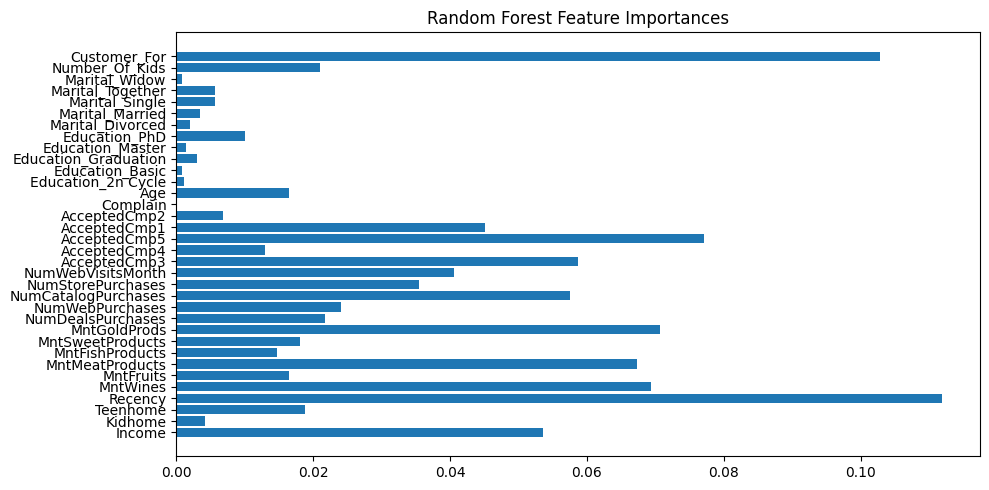

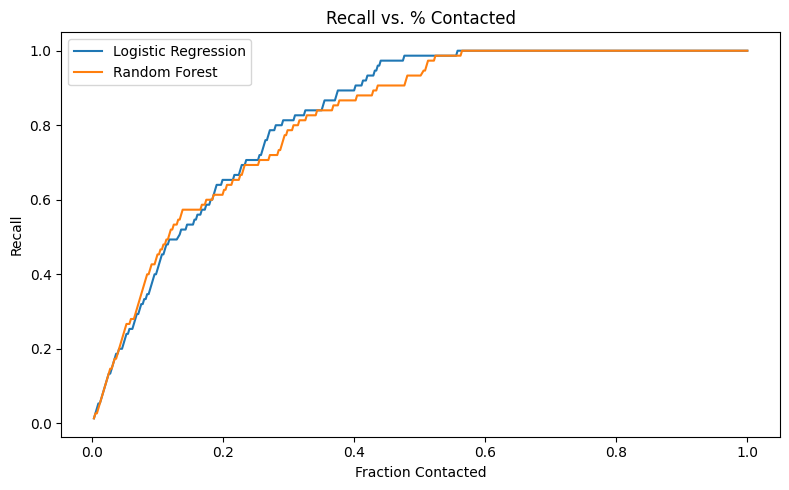

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

def plot_summary_table(df_results):
    fig, ax = plt.subplots(figsize=(10, 4))
    sns.heatmap(df_results.set_index('Model').T, annot=True, fmt='.2f', cmap='Blues', cbar=False, ax=ax)
    plt.title("Summary Metrics (Higher is better except FN/FP)")
    plt.tight_layout()
    plt.show()

def plot_confusion_matrices(details):
    fig, axes = plt.subplots(1, 2, figsize=(10, 4))
    for i, (model, info) in enumerate(details.items()):
        cm = info['conf_matrix']
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=axes[i])
        axes[i].set_title(f'{model} Confusion Matrix')
        axes[i].set_xlabel('Predicted')
        axes[i].set_ylabel('Actual')
        axes[i].set_xticklabels(['Negative', 'Positive'])
        axes[i].set_yticklabels(['Negative', 'Positive'])
    plt.tight_layout()
    plt.show()

def plot_roc_curves(details):
    plt.figure(figsize=(8, 5))
    for model, info in details.items():
        fpr, tpr, _ = info['roc_curve']
        auc = roc_auc_score(y_true=info['conf_matrix'].sum(axis=1), y_score=[0,1])
        plt.plot(fpr, tpr, label=f"{model} (AUC={auc:.2f})")
    plt.plot([0,1],[0,1],'k--',alpha=0.5)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate (Recall)')
    plt.title('ROC Curve')
    plt.legend()
    plt.tight_layout()
    plt.show()

def plot_pr_curves(details):
    plt.figure(figsize=(8, 5))
    for model, info in details.items():
        precision, recall, _ = info['pr_curve']
        plt.plot(recall, precision, label=model)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend()
    plt.tight_layout()
    plt.show()

def plot_profit_curve(details, y_test, revenue_per_tp=11, cost_per_contact=3):
    plt.figure(figsize=(8,5))
    for model, info in details.items():
        precision, recall, thresholds = info['pr_curve']
        profits = []
        for t in thresholds:
            preds = (info['y_proba'] >= t).astype(int)
            TP = ((preds==1) & (y_test==1)).sum()
            FP = ((preds==1) & (y_test==0)).sum()
            total_contacted = TP + FP
            profit = TP*revenue_per_tp - total_contacted*cost_per_contact
            profits.append(profit)
        plt.plot(thresholds, profits, label=model)
    plt.xlabel('Threshold')
    plt.ylabel('Net Profit')
    plt.title('Profit Curve (Business Value)')
    plt.legend()
    plt.tight_layout()
    plt.show()

def plot_feature_importances_and_coefs(details, feature_names):
    # Logistic Regression Coefs
    coefs = details['Logistic Regression']['coef'].flatten()
    plt.figure(figsize=(10, 5))
    plt.barh(feature_names, coefs)
    plt.title('Logistic Regression Coefficients')
    plt.axvline(0, color='k', linestyle='--', lw=1)
    plt.tight_layout()
    plt.show()

    # Random Forest Importances
    importances = details['Random Forest']['feature_importances']
    plt.figure(figsize=(10, 5))
    plt.barh(feature_names, importances)
    plt.title('Random Forest Feature Importances')
    plt.tight_layout()
    plt.show()

def plot_contact_vs_recall_curve(details, y_test):
    plt.figure(figsize=(8,5))
    for model, info in details.items():
        precision, recall, thresholds = info['pr_curve']
        recalls = []
        pct_contacted = []
        for t in thresholds:
            preds = (info['y_proba'] >= t).astype(int)
            recall_score_val = recall_score(y_test, preds)
            pct_contacted_val = preds.mean()
            recalls.append(recall_score_val)
            pct_contacted.append(pct_contacted_val)
        plt.plot(pct_contacted, recalls, label=model)
    plt.xlabel('Fraction Contacted')
    plt.ylabel('Recall')
    plt.title('Recall vs. % Contacted')
    plt.legend()
    plt.tight_layout()
    plt.show()

# Example of calling these functions (assuming you have results and details):

plot_summary_table(df_results['summary'])
plot_confusion_matrices(df_results['details'])
plot_roc_curves(df_results['details'])
plot_pr_curves(df_results['details'])
plot_profit_curve(df_results['details'], y_test)
plot_feature_importances_and_coefs(df_results['details'], X_test.columns)
plot_contact_vs_recall_curve(df_results['details'], y_test)
